In [1]:
import sys
import typing as tp
from pathlib import Path

import matplotlib.pyplot as plt
import numpy as np
import torch
from torch import nn

sys.path.append('../')
from src.data.psf import get_psf
from src.data.convolution import convolve, convolve_tensors
from src.data.utils import read_image
from src.deconv.classic.wiener import wiener_rgb, wiener_gray
from src.deconv.neural.usrnet.predictor import USRNetPredictor

plt.gray()

<Figure size 640x480 with 0 Axes>

In [10]:
def get_psfs(
    s_range: np.array,
    c_range: np.array,
    a: float | int,
    s_fixed: float,
    c_fixed: float,
    num_psfs: int,
    pupil_diam: float = 4,
    view_dist: float = 100, 
    canvas_size_h: float = 10,
) -> tp.Tuple[dict, dict]:
    """Get PSFs in correct forn=mat for `viz_robustness()`"""
    
    psfs = {}
    for i in range(num_psfs):
        psfs[i] = {
            'psf': get_psf(s=s_range[i], a=a, c=c_range[i], pupil_diam=pupil_diam, view_dist=view_dist, canvas_size_h=canvas_size_h),
            'params': {
                'S': s_range[i],
                'A': a,
                'C': c_range[i],
            }
        }

        psf_fixed = {
            'psf': get_psf(s=s_fixed, a=a, c=c_fixed, pupil_diam=pupil_diam, view_dist=view_dist, canvas_size_h=canvas_size_h),
            'params': {
                'S': s_fixed,
                'A': a,
                'C': c_fixed,
            }
        }
    return psfs, psf_fixed


def get_param_string(param_dict: dict) -> str:
    param_string = ' '
    for key, value in param_dict.items():
        param_string += f'{key}: {round(value, 3)} '
    return param_string


def viz_robustness(
    image: np.array,
    psfs: dict,
    psf_fixed: dict,
    deconv_algo: tp.Callable,
    neural_model: nn.Module,
    noise: tp.Optional[np.array] = None,
    balance_correct: float = 1e-8,
    balance_incorrect: float = 1e-3, 
):
    """Vizulize robustness of an algorithm.

    Parameters
    ----------
    image : np.array
        Sharp image
    psfs : dict
        Dictionary with psfs (np.array) and their params (dict)
    psf_fixed : np.array
        Dictionary with the fixed PSF (assumed to be the `true' PSF) from which the blurred image is convolved and its params.
    deconv_algo : tp.Callable
        Deconvolution algorithm.
    """
    num_psfs = len(psfs)
    fig, axs = plt.subplots(num_psfs, 12, figsize=(5 * 14, 5 * num_psfs))

    for i in range(num_psfs):
        psf_correct = psfs[i]['psf']
        psf_correct_params = psfs[i]['params']

        psf_incorrect = psf_fixed['psf']
        psf_incorrect_params = psf_fixed['params']

        # algorithm
        blurred_image = convolve(image, psf_correct)
        blurred_noised_image = blurred_image + noise

        restored_image_correct_algo = deconv_algo(blurred_image, psf_correct, balance=balance_correct)
        restored_image_incorrect_algo = deconv_algo(blurred_image, psf_incorrect, balance=balance_incorrect)

        restored_noised_image_correct_algo = deconv_algo(blurred_noised_image, psf_correct, balance=balance_incorrect)
        restored_noised_image_incorrect_algo = deconv_algo(blurred_noised_image, psf_incorrect, balance=balance_incorrect)

        # neural net
        blurred_image_tensor = convolve_tensors(image, psf_correct)
        blurred_noised_image_tensor = blurred_image_tensor + torch.tensor(noise)

        restored_image_correct_nn = neural_model.forward(blurred_image_tensor, psf_correct)[0]
        restored_image_incorrect_nn = neural_model.forward(blurred_image_tensor, psf_incorrect)[0]

        restored_noised_image_correct_nn = neural_model.forward(blurred_noised_image_tensor, psf_correct)[0]
        restored_noised_image_incorrect_nn = neural_model.forward(blurred_noised_image_tensor, psf_incorrect)[0]

        axs[i, 0].imshow(blurred_image)
        axs[i, 0].axis('off')
        axs[i, 0].set_title('Blurred (w/ corr. PSF)')

        axs[i, 1].imshow(np.clip(blurred_noised_image, 0, 1))
        axs[i, 1].axis('off')
        axs[i, 1].set_title('Blurred noised (w/ corr. PSF)')

        axs[i, 2].imshow(psf_correct)
        axs[i, 2].axis('off')
        axs[i, 2].set_title(f'Corr. PSF | ' + get_param_string(psf_correct_params))

        axs[i, 3].imshow(np.clip(restored_image_correct_algo, 0, 1))
        axs[i, 3].axis('off')
        axs[i, 3].set_title('Restored (ALGO: w/ corr. PSF)')

        axs[i, 4].imshow(np.clip(restored_image_correct_nn, 0, 1))
        axs[i, 4].axis('off')
        axs[i, 4].set_title('Restored (NN: w/ corr. PSF)')

        axs[i, 5].imshow(np.clip(restored_noised_image_correct_algo, 0, 1))
        axs[i, 5].axis('off')
        axs[i, 5].set_title('Restored noised (ALGO: w/ corr. PSF)')

        axs[i, 6].imshow(np.clip(restored_noised_image_correct_nn, 0, 1))
        axs[i, 6].axis('off')
        axs[i, 6].set_title('Restored noised (NN: w/ corr. PSF)')

        axs[i, 7].imshow(psf_incorrect)
        axs[i, 7].axis('off')
        axs[i, 7].set_title(f'Incorr. PSF | ' + get_param_string(psf_incorrect_params))

        axs[i, 8].imshow(np.clip(restored_image_incorrect_algo, 0, 1))
        axs[i, 8].axis('off')
        axs[i, 8].set_title('Restored (ALGO: w/ incorr. PSF)')

        axs[i, 9].imshow(np.clip(restored_image_incorrect_nn, 0, 1))
        axs[i, 9].axis('off')
        axs[i, 9].set_title('Restored (NN: w/ incorrect PSF)')

        axs[i, 10].imshow(np.clip(restored_noised_image_incorrect_algo, 0, 1))
        axs[i, 10].axis('off')
        axs[i, 10].set_title('Restored noised (ALGO: w/ incorr. PSF)')

        axs[i, 11].imshow(np.clip(restored_noised_image_incorrect_nn, 0, 1))
        axs[i, 11].axis('off')
        axs[i, 11].set_title('Restored noised (NN: w/ incorr. PSF)')

# Restoration

In [4]:
usrnet = USRNetPredictor(
    model_path='../models/usrnet.pth',
    scale_factor=1,
    noise_level=0,
    device='cpu',
)

In [6]:
icons = list(Path('/home/chaganovaob/edu/deconv-data/deconvolution-benchmark/data/icons_jpg').rglob('*.png'))
faces = list(Path('/home/chaganovaob/edu/deconv-data/deconvolution-benchmark/data/images/faces').rglob('*.jpg'))
animals = list(Path('/home/chaganovaob/edu/deconv-data/deconvolution-benchmark/data/images/animals').rglob('*.jpg'))

image = read_image(str(icons[0]))
image_face = read_image(str(faces[0]))
image_animal = read_image(str(animals[1]))

noise = np.random.normal(loc=0, scale=0.01, size=image.shape)
noise.min(), noise.mean(), noise.max()

(-0.051060562440641916, -9.419456926164066e-06, 0.047311910238180925)

## 1 Small PSFs

Проверка робастности алгоритма к ошибкам в оценке PSF:
1. Изображение размывается с PSF correct;

2. На вход алгоритму подается изображение (1) и PSF incorrect (численные значения параметров отлтичаются от PSF correct; форма ядра остается та же)

In [7]:
num_psfs = 5

psfs, psf_fixed = get_psfs(
    s_range=np.linspace(-2, -1.9, num_psfs),
    a=60,
    c_range=np.linspace(-3, -2.9, num_psfs),
    s_fixed=-2,
    c_fixed=-3,
    num_psfs=num_psfs,
    pupil_diam=4,
    view_dist=100,
    canvas_size_h=10,
)

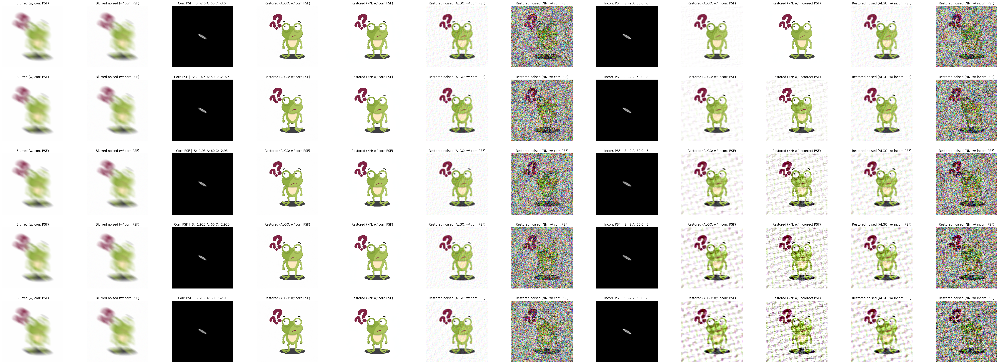

In [11]:
viz_robustness(image, psfs, psf_fixed, noise=noise, deconv_algo=wiener_rgb, neural_model=usrnet, balance_correct=1e-8, balance_incorrect=1e-2)

## 2 Big PSFs

In [12]:
num_psfs = 5

psfs, psf_fixed = get_psfs(
    s_range=np.linspace(-10, -9.9, num_psfs),
    a=60,
    c_range=np.linspace(-3, -2.9, num_psfs),
    s_fixed=-10,
    c_fixed=-3,
    num_psfs=num_psfs,
    pupil_diam=4,
    view_dist=100,
    canvas_size_h=10,
)

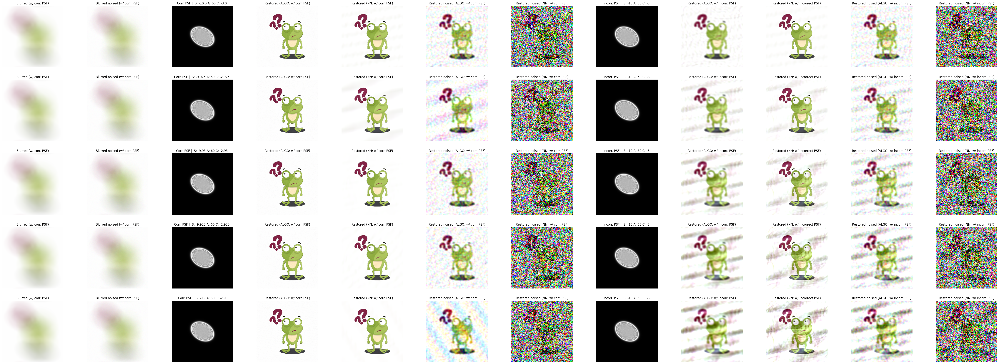

In [13]:
viz_robustness(image, psfs, psf_fixed, noise=noise, deconv_algo=wiener_rgb, neural_model=usrnet, balance_correct=1e-8, balance_incorrect=1e-2)

## 3 Different sizes

In [14]:
num_psfs = 5

psfs, psf_fixed = get_psfs(
    s_range=np.linspace(-7, -4, num_psfs),
    a=166,
    c_range=np.linspace(-3, -1, num_psfs),
    s_fixed=-5.5,
    c_fixed=-2,
    num_psfs=num_psfs,
    pupil_diam=4,
    view_dist=100,
    canvas_size_h=10,
)

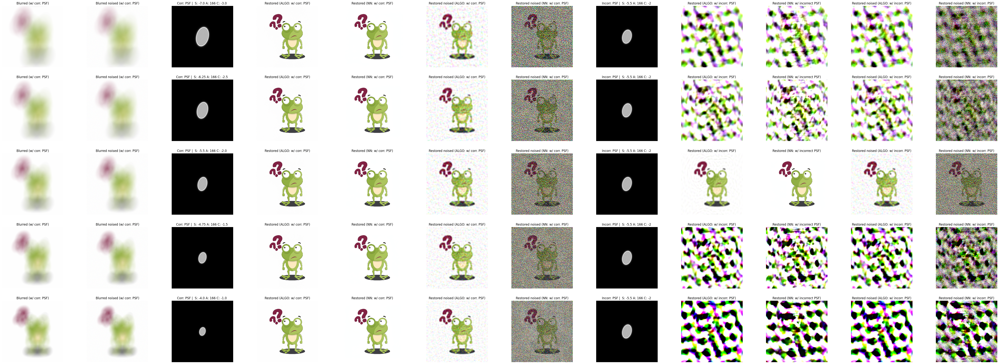

In [15]:
viz_robustness(image, psfs, psf_fixed, noise=noise, deconv_algo=wiener_rgb, neural_model=usrnet,  balance_correct=1e-8, balance_incorrect=1e-2)

# 4 The smallest error in PSF 

In [23]:
num_psfs = 2

psfs, psf_fixed = get_psfs(
    s_range=np.linspace(-2, -2.05, num_psfs),
    a=60,
    c_range=np.linspace(-2, -2.05, num_psfs),
    s_fixed=-2,
    c_fixed=-2,
    num_psfs=num_psfs,
    pupil_diam=4,
    view_dist=100,
    canvas_size_h=10,
)

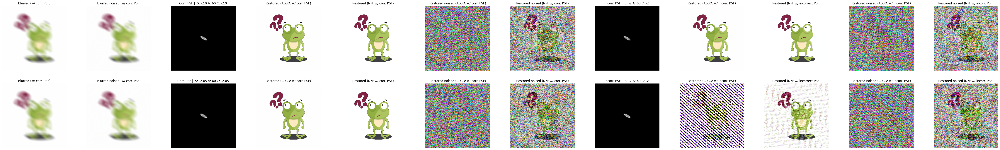

In [24]:
viz_robustness(image, psfs, psf_fixed, noise=noise, deconv_algo=wiener_rgb, neural_model=usrnet,  balance_correct=1e-8, balance_incorrect=1e-8)

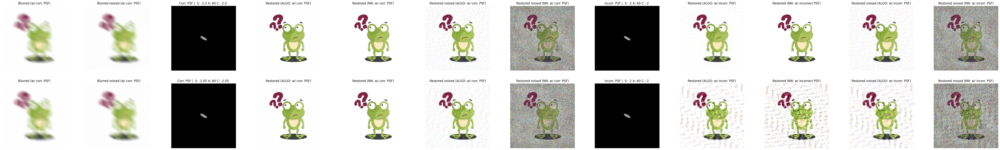

In [25]:
viz_robustness(image, psfs, psf_fixed, noise=noise, deconv_algo=wiener_rgb, neural_model=usrnet,  balance_correct=1e-8, balance_incorrect=1e-2)